<a href="https://colab.research.google.com/github/HanqiLouis/IPEO_Project2024/blob/main/PseudoRGB_3channels_Grayscale.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Idea: transform the hillshade files into grayscale images and learn using only them.

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
!pip install ultralytics

In [ ]:
import json
import numpy as np
import random
import matplotlib.pyplot as plt
import matplotlib.patches as patches
import tifffile
import os

In [ ]:
data_root = '/content/drive/MyDrive/IPEO/Project/LargeRocksDetectionDataset'

In [ ]:
# Illustration of some samples coming from the dataset
json_file_path = os.path.join(data_root, 'large_rock_dataset.json')

# Load the JSON file
with open(json_file_path, 'r') as json_file:
    data = json.load(json_file)
print('Genreal information about the data:', data['info'])
dataset = data['dataset']
print('Number of samples:', len(dataset))
sample_info = dataset[10]
print('Looking at the first images:', sample_info['file_name'])
print('Looking at rocks annotations for the firsdt images:\n', sample_info['rocks_annotations'][0])

Genreal information about the data: {'description': 'Large Rocks Detection Dataset ', 'version': '1.0', 'year': 2024, 'contributor': 'Valerie Zermatten', 'date_created': '2024/09/30'}
Number of samples: 992
Looking at the first images: 2581_1126_2_2.tif
Looking at rocks annotations for the firsdt images:
 {'rock_id': 1459.0, 'abs_rock_coordinates': [2581767.93, 1126509.48], 'pixel_within_patch_coordinates': [608.0, 51.0], 'relative_within_patch_location': [0.95, 0.08]}


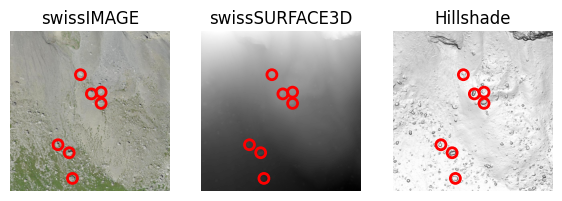

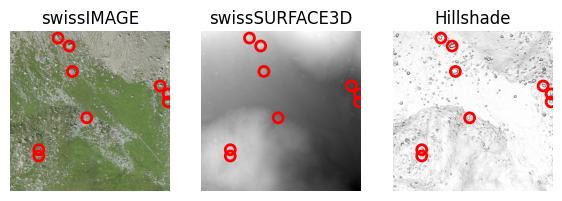

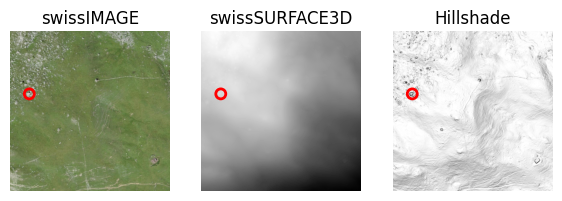

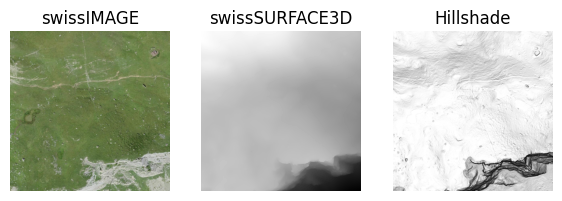

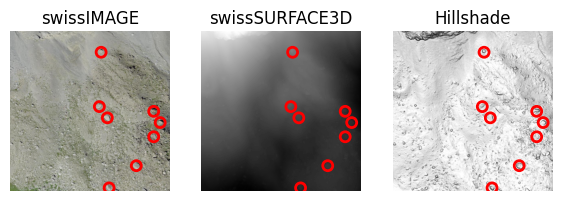

In [ ]:
def plot_images_with_bboxes(sample_info):

  src_SI = os.path.join(data_root, 'swissImage_50cm_patches', sample_info['file_name'])
  src_SS = os.path.join(data_root, 'swissSURFACE3D_patches', sample_info['file_name'])
  src_HS = os.path.join(data_root, 'swissSURFACE3D_hillshade_patches', sample_info['file_name'])

  # Read and draw the bounding boxes
  bboxes = sample_info['rocks_annotations'] # Assuming each image has an 'annotations' field containing the bounding boxes
  img_SI = tifffile.imread(src_SI)

  # Open and display the image
  image = tifffile.imread(src_SI)
  fig, ax = plt.subplots(1, 3, figsize=(7, 7))
  ax[0].imshow(image)
  ax[0].axis('off')
  ax[0].set_title('swissIMAGE')

  for box in bboxes:
    x, y = box['pixel_within_patch_coordinates']
    # draw the squares as a patch (red square)
    circ = patches.Circle((x, y), radius=20, linewidth=2, edgecolor='r', facecolor='none')
    ax[0].add_patch(circ)

  dsm = tifffile.imread(src_SS)
  ax[1].imshow(dsm, cmap='gist_gray')
  ax[1].axis('off')
  ax[1].set_title('swissSURFACE3D')

  for box in bboxes:
    x, y = box['pixel_within_patch_coordinates']
    # draw the circles as a patch (red cirlce)
    circ = patches.Circle((x, y), radius=20, linewidth=2, edgecolor='r', facecolor='none')
    ax[1].add_patch(circ)

  hillshade = tifffile.imread(src_HS)
  ax[2].imshow(hillshade, cmap='gist_gray')
  ax[2].axis('off')
  ax[2].set_title('Hillshade')

  for box in bboxes:
    x, y = box['pixel_within_patch_coordinates']
    # draw the squares as a patch (red square)
    circ = patches.Circle((x, y), radius=20, linewidth=2, edgecolor='r', facecolor='none')
    ax[2].add_patch(circ)

  # Show the plot with bounding boxes
  plt.show()

for k in range(5):
  #random.shuffle(dataset)
  plot_images_with_bboxes(dataset[k])

In [ ]:
src_SI = os.path.join(data_root, 'swissImage_50cm_patches', sample_info['file_name'])
src_SS = os.path.join(data_root, 'swissSURFACE3D_patches', sample_info['file_name'])
src_HS = os.path.join(data_root, 'swissSURFACE3D_hillshade_patches', sample_info['file_name'])

image = tifffile.imread(src_SI)
dsm = tifffile.imread(src_SS)
hillshade = tifffile.imread(src_HS)

print(hillshade)
print(hillshade.shape)
print(hillshade.max())
print(hillshade.min())

[[216.79274 218.06143 219.6755  ... 239.2359  243.70714 248.40178]
 [224.27411 213.34557 218.84186 ... 247.7203  244.27507 245.15239]
 [239.61852 215.51332 213.392   ... 252.3335  247.93512 244.42511]
 ...
 [247.11565 247.32167 245.34015 ... 221.73416 224.01382 227.54247]
 [243.61546 244.59349 244.38242 ... 219.74823 223.6684  227.20543]
 [241.9735  242.10663 243.7013  ... 218.26819 218.91324 217.53561]]
(640, 640)
255.0
4.9461923


In [ ]:
import os
import json

image_width = 640
image_height = 640

box_width = 20
box_height = 20

width_normalized = box_width / image_width
height_normalized = box_height / image_height

# Output directory for the label files
output_dir = os.path.join(data_root, 'labels')
os.makedirs(output_dir, exist_ok=True)  # Create the directory if it doesn't exist

json_file_path = os.path.join(data_root, 'large_rock_dataset.json')

# Load the JSON file
with open(json_file_path, 'r') as json_file:
    data = json.load(json_file)

print('General information about the data:', data['info'])
dataset = data['dataset']
print('Number of samples:', len(dataset))

# Loop through the dataset
for sample in dataset:
    file_name = sample['file_name']
    print(file_name)

    bboxes = sample['rocks_annotations']
    output_file = os.path.join(output_dir, file_name.replace(".tif", ".txt"))

    # Open the output file in write mode only once per file
    with open(output_file, "w") as f:
        for box in bboxes:
            x, y = box['relative_within_patch_location']
            # Write each rock's annotation to the file
            f.write(f"0 {x} {y} {width_normalized:.3f} {height_normalized:.3f}\n")


General information about the data: {'description': 'Large Rocks Detection Dataset ', 'version': '1.0', 'year': 2024, 'contributor': 'Valerie Zermatten', 'date_created': '2024/09/30'}
Number of samples: 992
2581_1126_0_0.tif
2581_1126_0_1.tif
2581_1126_0_2.tif
2581_1126_0_3.tif
2581_1126_1_0.tif
2581_1126_1_1.tif
2581_1126_1_2.tif
2581_1126_1_3.tif
2581_1126_2_0.tif
2581_1126_2_1.tif
2581_1126_2_2.tif
2581_1126_2_3.tif
2581_1126_3_0.tif
2581_1126_3_1.tif
2581_1126_3_2.tif
2581_1126_3_3.tif
2581_1127_0_0.tif
2581_1127_0_1.tif
2581_1127_0_2.tif
2581_1127_0_3.tif
2581_1127_1_0.tif
2581_1127_1_1.tif
2581_1127_1_2.tif
2581_1127_1_3.tif
2581_1127_2_0.tif
2581_1127_2_1.tif
2581_1127_2_2.tif
2581_1127_2_3.tif
2581_1127_3_0.tif
2581_1127_3_1.tif
2581_1127_3_2.tif
2581_1127_3_3.tif
2582_1126_0_0.tif
2582_1126_0_1.tif
2582_1126_0_2.tif
2582_1126_0_3.tif
2582_1126_1_0.tif
2582_1126_1_1.tif
2582_1126_1_2.tif
2582_1126_1_3.tif
2582_1126_2_0.tif
2582_1126_2_1.tif
2582_1126_2_2.tif
2582_1126_2_3.tif
2

File name: 2582_1126_1_1.tif
Number of rocks: 14
Number of labels: 14


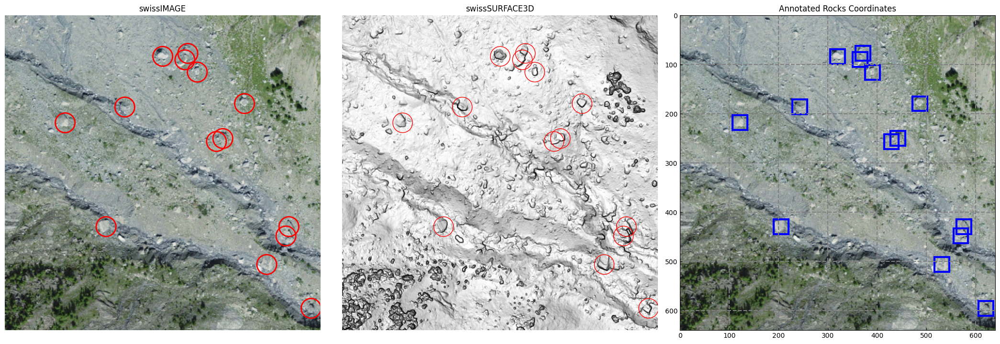

In [ ]:
image_width = 640
image_height = 640

# Assuming data, data_root, and sample_info are already defined
dataset = data['dataset']
idx = np.random.randint(0, len(dataset))

file_name = dataset[idx]['file_name']
print('File name:', file_name)
src_SI = os.path.join(data_root, 'swissImage_50cm_patches', file_name)
src_HS = os.path.join(data_root, 'swissSURFACE3D_hillshade_patches', file_name)
src_LAB = os.path.join(data_root, 'labels', file_name.replace(".tif", ".txt"))

bboxes = dataset[idx]['rocks_annotations']  # Bounding boxes

# Load the swissIMAGE and swissSURFACE3D images
image = tifffile.imread(src_SI)
dsm = tifffile.imread(src_HS)

# Create a figure with 3 subplots
fig, ax = plt.subplots(1, 3, figsize=(21, 7))

# Plot swissIMAGE
ax[0].imshow(image)
ax[0].axis('off')
ax[0].set_title('swissIMAGE')

# Add rocks annotations (red circles) to swissIMAGE
rocks = 0
for box in bboxes:
    x, y = box['pixel_within_patch_coordinates']
    circ = patches.Circle((x, y), radius=20, linewidth=2, edgecolor='r', facecolor='none')
    ax[0].add_patch(circ)
    rocks += 1
print(f"Number of rocks: {rocks}")

# Plot swissSURFACE3D
ax[1].imshow(dsm, cmap='gist_gray')
ax[1].axis('off')
ax[1].set_title('swissSURFACE3D')

# Add rocks annotations (red circles) to swissIMAGE
for box in bboxes:
    x, y = box['pixel_within_patch_coordinates']
    circ = patches.Circle((x, y), radius=20, linewidth=1, edgecolor='r', facecolor='none')
    ax[1].add_patch(circ)

# For the third plot, use the same background as swissSURFACE3D
ax[2].imshow(image)  # Use the DSM as the background
ax[2].set_title('Annotated Rocks Coordinates')
ax[2].grid(True, which='both', color='gray', linestyle='--', linewidth=1.5)  # Add grid
ax[2].tick_params(axis='both', which='both', direction='in')  # Add tick marks

# txt file
x_coords = []
y_coords = []

with open(src_LAB, 'r') as file:
  for line in file:
    parts = line.strip().split()
    #print(len(parts))
    if len(parts) >= 5:
      try:
        x = float(parts[1]) * image_width
        y = float(parts[2]) * image_height
        x_coords.append(x)
        y_coords.append(y)
      except ValueError:
        print(f"No rock found or invalid line")

rect_width = 30
rect_height = 30
for j in range(len(x_coords)):
    # Convert center coordinates to bottom-left corner coordinates
    bottom_left_x = x_coords[j] - rect_width / 2
    bottom_left_y = y_coords[j] - rect_height / 2

    # Create the rectangle
    rect = patches.Rectangle((bottom_left_x, bottom_left_y), rect_width, rect_height,
                             linewidth=3, edgecolor='b', facecolor='none')
    ax[2].add_patch(rect)

print(f"Number of labels: {len(x_coords)}")
# Display the plots
plt.tight_layout()
plt.show()

# Google Colab YOLOv8

## Random infos:
- labels in txt files, format

```
<class_label> <x_center_relative> <y_center_relative> <width_relative> <height_relative>
```
class label: int, class of the object
x_center_relative = x_center_coords / image_width
y_center_relative = y_center_coords / image_height
width_relative = label_box_width / image_width
height_relative = label_box_height / image_height

Exmple: 0 0.51 0.39 0.047 0.047

File name has to be exactly the same as the image (except .txt instead of .tif)

- Naming: \
Image folder: images -> train and/or val and or test\
Labels folder: labels -> train and/or val and or test\
MUST KEEP THE NAMES AS ABOVE!

- Native YOLOv8 only accept 3 channels inputs, but possible to accept 1 channel or 4 (RGBD) channels by modifying the internal files (I tried but for the moment I still haven't managed to make it work)

- 'labels' and 'images' folders should be kept in the same directory

In [ ]:
import yaml

# Define the YAML content as a Python dictionary
yamlGS_content = {
    "path": f'{data_root}/PseudoRGB',  # Root directory of the dataset
    "train": "images/train",  # Directory of the train images (relative to 'path)
    "val": "images/val",  # Directory of the val images (relative to 'path)
    "names": {
        0: "large rock"
    }
}

# File path for the output YAML file
output_fileGS = os.path.join(data_root, 'datasetPseudoRGB_config.yaml')

# Write the YAML content to the file
with open(output_fileGS, "w") as file:
    yaml.dump(yamlGS_content, file, default_flow_style=False)

print(f"YAML GS file '{output_fileGS}' created successfully!")

YAML GS file '/content/drive/MyDrive/IPEO/Project/LargeRocksDetectionDataset/datasetPseudoRGB_config.yaml' created successfully!


In [ ]:
# List all image files in the training directory
image_files = sorted([f for f in os.listdir(os.path.join(data_root, 'swissSURFACE3D_hillshade_patches')) if f.endswith(".tif")])

# Dataset splitting
random.seed(60)
random.shuffle(image_files)

train_split = int(0.75 * len(image_files))  # 75% of the dataset for training
val_split = int(0.25 * len(image_files))  # 25% for validation and the rest 0% for testing

# Save the images into different sets
data_splits = {
    'train': image_files[:train_split],
    'val': image_files[train_split:train_split + val_split],
    'test': image_files[train_split + val_split:],
}

print("Nb train:", len(data_splits['train']), "Nb val:", len(data_splits['val']), "Nb test:", len(data_splits['test'])) # No test set yet, will change that later

Nb train: 744 Nb val: 248 Nb test: 0


In [ ]:
import os
import numpy as np
from tifffile import imread, imwrite

# Define paths
dsm_folder = os.path.join(data_root, 'swissSURFACE3D_hillshade_patches')       # Folder containing 1-channel DSM files
output_folder = os.path.join(data_root, 'PseudoRGB')  # Folder to save 3-channel DSM files
os.makedirs(output_folder, exist_ok=True)

# Loop through all DSM files
for dsm_file in os.listdir(dsm_folder):
    if dsm_file.endswith(".tif"):  # Process only .tif files
        dsm_path = os.path.join(dsm_folder, dsm_file)
        output_path = os.path.join(output_folder, dsm_file)

        # Load DSM file
        dsm_image = imread(dsm_path)  # Shape: (H, W)

        # Normalize DSM to 0–255 if needed
        dsm_image = np.clip(dsm_image, 0, 255).astype(np.uint8)

        # Stack the DSM data into 3 channels
        dsm_3_channel = np.stack([dsm_image] * 3, axis=-1)  # Shape: (H, W, 3)

        # Save the 3-channel image
        imwrite(output_path, dsm_3_channel)
        print(f"Saved 3-channel DSM image: {output_path}")


Saved 3-channel DSM image: /content/drive/MyDrive/IPEO/Project/LargeRocksDetectionDataset/PseudoRGB/2640_1105_1_0.tif
Saved 3-channel DSM image: /content/drive/MyDrive/IPEO/Project/LargeRocksDetectionDataset/PseudoRGB/2586_1132_0_0.tif
Saved 3-channel DSM image: /content/drive/MyDrive/IPEO/Project/LargeRocksDetectionDataset/PseudoRGB/2611_1139_3_0.tif
Saved 3-channel DSM image: /content/drive/MyDrive/IPEO/Project/LargeRocksDetectionDataset/PseudoRGB/2611_1139_2_0.tif
Saved 3-channel DSM image: /content/drive/MyDrive/IPEO/Project/LargeRocksDetectionDataset/PseudoRGB/2634_1145_3_1.tif
Saved 3-channel DSM image: /content/drive/MyDrive/IPEO/Project/LargeRocksDetectionDataset/PseudoRGB/2635_1145_0_1.tif
Saved 3-channel DSM image: /content/drive/MyDrive/IPEO/Project/LargeRocksDetectionDataset/PseudoRGB/2635_1146_2_0.tif
Saved 3-channel DSM image: /content/drive/MyDrive/IPEO/Project/LargeRocksDetectionDataset/PseudoRGB/2586_1132_1_3.tif
Saved 3-channel DSM image: /content/drive/MyDrive/IPEO/P

In [ ]:
import shutil

# Define the directory structure
base_dir = os.path.join(data_root, 'PseudoRGB', 'images')
train_dir = os.path.join(base_dir, 'train')
val_dir = os.path.join(base_dir, 'val')

#files_folder = os.path.join(data_root, 'swissSURFACE3D_hillshade_patches')
files_folder = os.path.join(data_root, 'PseudoRGB')

# Create the directories
os.makedirs(train_dir, exist_ok=True)
os.makedirs(val_dir, exist_ok=True)

# Copy files to the train folder
for file_path in data_splits['train']:
    shutil.move(os.path.join(files_folder, file_path), train_dir)

# Copy files to the val folder
for file_path in data_splits['val']:
    shutil.move(os.path.join(files_folder, file_path), val_dir)

print("Pseudo RGB image files have been successfully moved!")

Pseudo RGB image files have been successfully moved!


In [ ]:
# Define the directory structure
base_dir_labels = os.path.join(data_root, 'PseudoRGB/labels')
train_dir_labels = os.path.join(base_dir_labels, 'train')
val_dir_labels = os.path.join(base_dir_labels, 'val')

labels_folder = os.path.join(data_root, 'labels')

# Create the directories
os.makedirs(train_dir_labels, exist_ok=True)
os.makedirs(val_dir_labels, exist_ok=True)

# Move corresponding `.txt` files to the train folder
for label_path in data_splits['train']:
    txt_file_name = os.path.splitext(label_path)[0] + ".txt"  # Replace .tif with .txt
    shutil.copy(os.path.join(labels_folder, txt_file_name), train_dir_labels)

# Move corresponding `.txt` files to the val folder
for label_path in data_splits['val']:
    txt_file_name = os.path.splitext(label_path)[0] + ".txt"  # Replace .tif with .txt
    shutil.copy(os.path.join(labels_folder, txt_file_name), val_dir_labels)

print("Label files have been successfully copied!")

Label files have been successfully copied!


In [ ]:
images_train = sorted([f for f in os.listdir(os.path.join(data_root, 'PseudoRGB/images/train')) if f.endswith(".tif")])

# Find the intersection and count the elements
intersection_train = set(images_train) & set(data_splits['train'])  # Intersection of the two lists
count_train = len(intersection_train)

images_val = sorted([f for f in os.listdir(os.path.join(data_root, 'PseudoRGB/images/val')) if f.endswith(".tif")])

# Find the intersection and count the elements
intersection_val = set(images_val) & set(data_splits['val'])  # Intersection of the two lists
count_val = len(intersection_val)

print("Number of elements in both lists (train):", count_train)
print("Number of total elements (train):", len(data_splits['train']))
print("Number of elements in both lists (val):", count_val)
print("Number of total elements (val):", len(data_splits['val']))

Number of elements in both lists (train): 744
Number of total elements (train): 744
Number of elements in both lists (val): 248
Number of total elements (val): 248


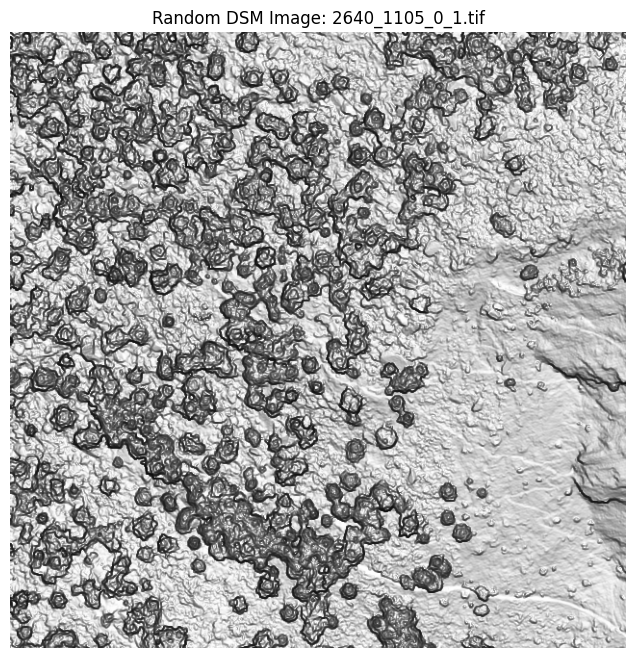

In [ ]:
import os
import numpy as np
import matplotlib.pyplot as plt
from tifffile import imread

# Path to the folder containing the new 3-channel DSM images
output_folder = os.path.join(data_root, 'PseudoRGB/images/train')

# List all files in the folder
dsm_files = [f for f in os.listdir(output_folder) if f.endswith(".tif")]

# Select a random file
import random
random_file = random.choice(dsm_files)
random_file_path = os.path.join(output_folder, random_file)

# Load the selected image
dsm_image = imread(random_file_path)  # Shape: (H, W, 3)

# Plot the image
plt.figure(figsize=(8, 8))
plt.imshow(dsm_image.astype(np.uint8))  # Ensure values are in range for display
plt.title(f"Random DSM Image: {random_file}")
plt.axis("off")
plt.show()


In [67]:
dsm_image.shape

(640, 640, 3)

In [ ]:
import os

from ultralytics import YOLO

# Load a model
model = YOLO("yolov8n.yaml")  # build a new model from scratch

# use the model
results = model.train(data=os.path.join(data_root, 'datasetPseudoRGB_config.yaml'), epochs=100) # train the model

Creating new Ultralytics Settings v0.0.6 file ✅ 
View Ultralytics Settings with 'yolo settings' or at '/root/.config/Ultralytics/settings.json'
Update Settings with 'yolo settings key=value', i.e. 'yolo settings runs_dir=path/to/dir'. For help see https://docs.ultralytics.com/quickstart/#ultralytics-settings.
Ultralytics 8.3.56 🚀 Python-3.10.12 torch-2.5.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
engine/trainer: task=detect, mode=train, model=yolov8n.yaml, data=/content/drive/MyDrive/IPEO/Project/LargeRocksDetectionDataset/datasetPseudoRGB_config.yaml, epochs=100, time=None, patience=100, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=train, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=v

100%|██████████| 755k/755k [00:00<00:00, 20.1MB/s]


Overriding model.yaml nc=80 with nc=1

                   from  n    params  module                                       arguments                     
  0                  -1  1       464  ultralytics.nn.modules.conv.Conv             [3, 16, 3, 2]                 
  1                  -1  1      4672  ultralytics.nn.modules.conv.Conv             [16, 32, 3, 2]                
  2                  -1  1      7360  ultralytics.nn.modules.block.C2f             [32, 32, 1, True]             
  3                  -1  1     18560  ultralytics.nn.modules.conv.Conv             [32, 64, 3, 2]                
  4                  -1  2     49664  ultralytics.nn.modules.block.C2f             [64, 64, 2, True]             
  5                  -1  1     73984  ultralytics.nn.modules.conv.Conv             [64, 128, 3, 2]               
  6                  -1  2    197632  ultralytics.nn.modules.block.C2f             [128, 128, 2, True]           
  7                  -1  1    295424  ultralytics

100%|██████████| 5.35M/5.35M [00:00<00:00, 83.4MB/s]


AMP: checks passed ✅


train: Scanning /content/drive/MyDrive/IPEO/Project/LargeRocksDetectionDataset/PseudoRGB/labels/train... 744 images, 325 backgrounds, 0 corrupt: 100%|██████████| 744/744 [01:54<00:00,  6.49it/s]

train: WARNING ⚠️ /content/drive/MyDrive/IPEO/Project/LargeRocksDetectionDataset/PseudoRGB/images/train/2588_1133_1_2.tif: 1 duplicate labels removed
train: WARNING ⚠️ /content/drive/MyDrive/IPEO/Project/LargeRocksDetectionDataset/PseudoRGB/images/train/2598_1132_0_3.tif: 2 duplicate labels removed
train: WARNING ⚠️ /content/drive/MyDrive/IPEO/Project/LargeRocksDetectionDataset/PseudoRGB/images/train/2598_1132_1_3.tif: 2 duplicate labels removed
train: WARNING ⚠️ /content/drive/MyDrive/IPEO/Project/LargeRocksDetectionDataset/PseudoRGB/images/train/2626_1102_3_0.tif: 1 duplicate labels removed
train: WARNING ⚠️ /content/drive/MyDrive/IPEO/Project/LargeRocksDetectionDataset/PseudoRGB/images/train/2704_1127_3_3.tif: 1 duplicate labels removed


train: New cache created: /content/drive/MyDrive/IPEO/Project/LargeRocksDetectionDataset/PseudoRGB/labels/train.cache
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))


/usr/local/lib/python3.10/dist-packages/albumentations/__init__.py:24: UserWarning: A new version of Albumentations is available: 1.4.24 (you have 1.4.20). Upgrade using: pip install -U albumentations. To disable automatic update checks, set the environment variable NO_ALBUMENTATIONS_UPDATE to 1.
  check_for_updates()
val: Scanning /content/drive/MyDrive/IPEO/Project/LargeRocksDetectionDataset/PseudoRGB/labels/val... 248 images, 118 backgrounds, 0 corrupt: 100%|██████████| 248/248 [00:35<00:00,  7.07it/s]

val: WARNING ⚠️ /content/drive/MyDrive/IPEO/Project/LargeRocksDetectionDataset/PseudoRGB/images/val/2582_1127_0_1.tif: 1 duplicate labels removed
val: WARNING ⚠️ /content/drive/MyDrive/IPEO/Project/LargeRocksDetectionDataset/PseudoRGB/images/val/2588_1133_0_2.tif: 1 duplicate labels removed
val: WARNING ⚠️ /content/drive/MyDrive/IPEO/Project/LargeRocksDetectionDataset/PseudoRGB/images/val/2626_1102_2_0.tif: 1 duplicate labels removed


val: New cache created: /content/drive/MyDrive/IPEO/Project/LargeRocksDetectionDataset/PseudoRGB/labels/val.cache
Plotting labels to runs/detect/train/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.002, momentum=0.9) with parameter groups 57 weight(decay=0.0), 64 weight(decay=0.0005), 63 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 640 train, 640 val
Using 2 dataloader workers
Logging results to runs/detect/train
Starting training for 100 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      1/100      2.68G      6.062      10.63      3.762         20        640: 100%|██████████| 47/47 [00:22<00:00,  2.10it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:06<00:00,  1.28it/s]

                   all        248        982          0          0          0          0



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      2/100      2.62G      3.992      4.749      2.416         44        640: 100%|██████████| 47/47 [00:19<00:00,  2.47it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.88it/s]

                   all        248        982          0          0          0          0



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      3/100      2.33G      3.355      4.027      1.927         62        640: 100%|██████████| 47/47 [00:18<00:00,  2.49it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:03<00:00,  2.39it/s]

                   all        248        982      0.121      0.109      0.044     0.0133



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      4/100      2.46G      3.124      3.558      1.769         58        640: 100%|██████████| 47/47 [00:19<00:00,  2.45it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:04<00:00,  1.69it/s]


                   all        248        982        0.1      0.105     0.0377      0.013

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      5/100      2.77G      2.913      3.319      1.634         41        640: 100%|██████████| 47/47 [00:18<00:00,  2.50it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:03<00:00,  2.03it/s]

                   all        248        982      0.118      0.118      0.049     0.0206



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      6/100      2.78G      2.755       3.18      1.524         27        640: 100%|██████████| 47/47 [00:18<00:00,  2.58it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.83it/s]

                   all        248        982      0.219       0.15      0.095     0.0365



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      7/100      2.59G      2.658      3.035      1.513         94        640: 100%|██████████| 47/47 [00:18<00:00,  2.52it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:03<00:00,  2.26it/s]


                   all        248        982      0.301      0.113      0.101      0.025

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      8/100      2.86G      2.563      2.864       1.45         93        640: 100%|██████████| 47/47 [00:18<00:00,  2.58it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:05<00:00,  1.40it/s]

                   all        248        982      0.215      0.179      0.105     0.0415



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      9/100      2.37G      2.498      2.922      1.433         55        640: 100%|██████████| 47/47 [00:18<00:00,  2.48it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:04<00:00,  1.90it/s]

                   all        248        982      0.274      0.206      0.146     0.0357



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     10/100      2.43G      2.401      2.734      1.385         23        640: 100%|██████████| 47/47 [00:18<00:00,  2.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.88it/s]

                   all        248        982      0.395      0.221      0.213     0.0606



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     11/100      2.39G      2.399      2.693      1.366         48        640: 100%|██████████| 47/47 [00:18<00:00,  2.50it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:05<00:00,  1.53it/s]


                   all        248        982      0.139      0.153     0.0581     0.0156

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     12/100      2.44G      2.349      2.649      1.356         41        640: 100%|██████████| 47/47 [00:18<00:00,  2.53it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:03<00:00,  2.65it/s]

                   all        248        982      0.367      0.246      0.214     0.0756



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     13/100      2.42G      2.289      2.581      1.326         22        640: 100%|██████████| 47/47 [00:18<00:00,  2.50it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:03<00:00,  2.57it/s]

                   all        248        982      0.385      0.298      0.249      0.101



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     14/100       2.6G      2.317        2.5      1.339         46        640: 100%|██████████| 47/47 [00:18<00:00,  2.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:04<00:00,  1.94it/s]


                   all        248        982     0.0718     0.0774     0.0183    0.00254

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     15/100      2.71G        2.2      2.432      1.312         41        640: 100%|██████████| 47/47 [00:18<00:00,  2.50it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:04<00:00,  1.78it/s]


                   all        248        982      0.466      0.233      0.244     0.0982

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     16/100      2.42G      2.278       2.61      1.321         56        640: 100%|██████████| 47/47 [00:18<00:00,  2.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:03<00:00,  2.66it/s]

                   all        248        982      0.541      0.171      0.216     0.0889



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     17/100      2.55G        2.3      2.588      1.321         28        640: 100%|██████████| 47/47 [00:18<00:00,  2.49it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.76it/s]

                   all        248        982      0.275       0.22       0.15     0.0373



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     18/100       2.3G      2.224      2.436      1.305         63        640: 100%|██████████| 47/47 [00:18<00:00,  2.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:05<00:00,  1.42it/s]

                   all        248        982      0.255      0.273      0.167     0.0391



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     19/100      2.65G      2.268      2.454      1.314         46        640: 100%|██████████| 47/47 [00:18<00:00,  2.59it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:03<00:00,  2.39it/s]

                   all        248        982     0.0311     0.0591    0.00718    0.00136



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     20/100      2.54G      2.228      2.353      1.294         48        640: 100%|██████████| 47/47 [00:18<00:00,  2.48it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.92it/s]


                   all        248        982      0.434      0.163      0.179      0.076

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     21/100      2.75G      2.158      2.412      1.262         14        640: 100%|██████████| 47/47 [00:19<00:00,  2.47it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:04<00:00,  1.89it/s]


                   all        248        982      0.355      0.304      0.247     0.0663

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     22/100      2.52G        2.3      2.441      1.308         18        640: 100%|██████████| 47/47 [00:18<00:00,  2.52it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:04<00:00,  1.72it/s]

                   all        248        982      0.265      0.215      0.126     0.0345



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     23/100      2.67G      2.134      2.311      1.267         11        640: 100%|██████████| 47/47 [00:18<00:00,  2.52it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.83it/s]


                   all        248        982      0.387      0.247      0.219      0.101

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     24/100      2.48G      2.164      2.345      1.279         74        640: 100%|██████████| 47/47 [00:18<00:00,  2.48it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.90it/s]

                   all        248        982      0.361      0.251      0.206      0.056



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     25/100      2.36G      2.154      2.321      1.279         34        640: 100%|██████████| 47/47 [00:18<00:00,  2.50it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:04<00:00,  1.97it/s]

                   all        248        982      0.474      0.146      0.178     0.0731



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     26/100         3G      2.104       2.23       1.24         95        640: 100%|██████████| 47/47 [00:19<00:00,  2.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:03<00:00,  2.23it/s]

                   all        248        982      0.468      0.344      0.325      0.138



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     27/100      2.56G      2.147      2.256      1.248         26        640: 100%|██████████| 47/47 [00:18<00:00,  2.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.82it/s]

                   all        248        982      0.344      0.196      0.169     0.0685



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     28/100      2.82G      2.161      2.263      1.259         24        640: 100%|██████████| 47/47 [00:18<00:00,  2.50it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.84it/s]

                   all        248        982      0.427      0.249      0.247       0.12



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     29/100      2.59G      2.164      2.237      1.259         43        640: 100%|██████████| 47/47 [00:18<00:00,  2.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:05<00:00,  1.44it/s]

                   all        248        982      0.356      0.282      0.229     0.0802



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     30/100      2.45G       2.12      2.239      1.246         69        640: 100%|██████████| 47/47 [00:18<00:00,  2.48it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.10it/s]

                   all        248        982      0.052     0.0428    0.00849    0.00133



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     31/100      2.82G      2.138      2.307      1.244         60        640: 100%|██████████| 47/47 [00:18<00:00,  2.52it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.87it/s]


                   all        248        982      0.355       0.23      0.182     0.0751

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     32/100      2.67G      2.095      2.248       1.23         49        640: 100%|██████████| 47/47 [00:18<00:00,  2.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:03<00:00,  2.00it/s]

                   all        248        982      0.523      0.151      0.203     0.0991



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     33/100      2.38G      2.079      2.207       1.24         69        640: 100%|██████████| 47/47 [00:18<00:00,  2.61it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:04<00:00,  1.80it/s]


                   all        248        982      0.376      0.303      0.248     0.0721

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     34/100      2.69G      2.056      2.198      1.192         68        640: 100%|██████████| 47/47 [00:18<00:00,  2.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.75it/s]

                   all        248        982      0.359      0.345       0.27       0.11



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     35/100      2.58G      2.074      2.229      1.215         49        640: 100%|██████████| 47/47 [00:18<00:00,  2.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.84it/s]

                   all        248        982      0.506      0.285      0.292      0.136



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     36/100      2.33G      2.076      2.302      1.237         35        640: 100%|██████████| 47/47 [00:18<00:00,  2.50it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:05<00:00,  1.51it/s]

                   all        248        982      0.597       0.22      0.282      0.136



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     37/100      3.05G      2.039      2.246      1.218         61        640: 100%|██████████| 47/47 [00:18<00:00,  2.47it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.93it/s]

                   all        248        982      0.425      0.239      0.227     0.0682



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     38/100      2.67G      2.049      2.181      1.197         17        640: 100%|██████████| 47/47 [00:18<00:00,  2.49it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.99it/s]


                   all        248        982      0.426      0.378      0.341      0.135

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     39/100      2.84G      2.023      2.218      1.195         30        640: 100%|██████████| 47/47 [00:18<00:00,  2.47it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:03<00:00,  2.25it/s]

                   all        248        982      0.431      0.339      0.304      0.114



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     40/100      2.58G      2.083      2.165      1.214         30        640: 100%|██████████| 47/47 [00:18<00:00,  2.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:04<00:00,  1.74it/s]


                   all        248        982      0.457      0.342      0.312      0.141

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     41/100      2.42G      2.103      2.207      1.226         62        640: 100%|██████████| 47/47 [00:18<00:00,  2.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.89it/s]


                   all        248        982      0.467      0.198      0.231     0.0978

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     42/100      2.64G      2.004      2.209      1.195         17        640: 100%|██████████| 47/47 [00:18<00:00,  2.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.68it/s]


                   all        248        982      0.443      0.303      0.296      0.138

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     43/100      2.33G      1.988      2.113      1.187         12        640: 100%|██████████| 47/47 [00:18<00:00,  2.49it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:04<00:00,  1.91it/s]

                   all        248        982      0.549      0.118      0.201     0.0789



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     44/100      2.54G      1.984      2.004      1.192         28        640: 100%|██████████| 47/47 [00:19<00:00,  2.44it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:03<00:00,  2.33it/s]

                   all        248        982       0.42      0.395       0.35      0.145



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     45/100      2.33G       2.06       2.16      1.207         77        640: 100%|██████████| 47/47 [00:18<00:00,  2.53it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.70it/s]

                   all        248        982      0.395      0.315      0.271     0.0623



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     46/100      2.77G       2.07       2.09      1.206         75        640: 100%|██████████| 47/47 [00:18<00:00,  2.48it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:03<00:00,  2.43it/s]

                   all        248        982      0.468      0.333      0.328      0.158



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     47/100      2.61G      2.049      2.152      1.209         45        640: 100%|██████████| 47/47 [00:19<00:00,  2.41it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:04<00:00,  1.88it/s]

                   all        248        982      0.457      0.359      0.337      0.148



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     48/100      2.46G      1.949       2.04      1.163         40        640: 100%|██████████| 47/47 [00:19<00:00,  2.47it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.97it/s]

                   all        248        982       0.47      0.341       0.33      0.158



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     49/100      2.34G      1.922          2      1.168         88        640: 100%|██████████| 47/47 [00:18<00:00,  2.48it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.86it/s]

                   all        248        982      0.431      0.345      0.312       0.14



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     50/100      2.78G      1.981      2.108      1.173         40        640: 100%|██████████| 47/47 [00:18<00:00,  2.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:05<00:00,  1.51it/s]

                   all        248        982      0.487      0.367      0.359      0.171



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     51/100      2.36G      1.982      2.087      1.179         17        640: 100%|██████████| 47/47 [00:18<00:00,  2.52it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.72it/s]


                   all        248        982      0.479      0.354      0.339      0.137

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     52/100      2.48G      1.982      2.004      1.185         24        640: 100%|██████████| 47/47 [00:18<00:00,  2.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.73it/s]

                   all        248        982      0.461      0.373       0.35      0.173



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     53/100      2.33G      1.958      2.091      1.175         27        640: 100%|██████████| 47/47 [00:18<00:00,  2.50it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:04<00:00,  1.74it/s]

                   all        248        982      0.514       0.35      0.352      0.154



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     54/100      2.51G      1.967      2.038      1.164         49        640: 100%|██████████| 47/47 [00:19<00:00,  2.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.88it/s]


                   all        248        982      0.472       0.39      0.361      0.131

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     55/100      2.45G      1.995      2.008      1.197         29        640: 100%|██████████| 47/47 [00:18<00:00,  2.53it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.74it/s]


                   all        248        982      0.339      0.292      0.228        0.1

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     56/100      2.39G      1.925      2.027      1.173         50        640: 100%|██████████| 47/47 [00:20<00:00,  2.35it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:03<00:00,  2.03it/s]

                   all        248        982      0.464      0.367      0.355      0.145



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     57/100      2.63G      1.996      2.079      1.177         28        640: 100%|██████████| 47/47 [00:18<00:00,  2.49it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:03<00:00,  2.14it/s]

                   all        248        982      0.506      0.368      0.379      0.189



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     58/100       2.6G      2.016      2.008      1.207         47        640: 100%|██████████| 47/47 [00:20<00:00,  2.25it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.84it/s]

                   all        248        982      0.466      0.198      0.215      0.107



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     59/100      2.69G      1.889      1.974      1.166         25        640: 100%|██████████| 47/47 [00:18<00:00,  2.49it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:04<00:00,  1.86it/s]

                   all        248        982      0.415      0.333      0.291      0.132



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     60/100      2.54G      1.921       1.96      1.161         96        640: 100%|██████████| 47/47 [00:19<00:00,  2.36it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.71it/s]

                   all        248        982      0.477      0.358      0.362      0.139



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     61/100      2.52G      1.857      1.901      1.139         30        640: 100%|██████████| 47/47 [00:18<00:00,  2.53it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:03<00:00,  2.46it/s]

                   all        248        982      0.492      0.351      0.345      0.116



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     62/100      2.65G       1.88      2.049      1.148         74        640: 100%|██████████| 47/47 [00:18<00:00,  2.52it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:03<00:00,  2.15it/s]

                   all        248        982      0.514       0.39      0.397      0.194



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     63/100      2.52G      1.898      1.939      1.151         42        640: 100%|██████████| 47/47 [00:22<00:00,  2.13it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:03<00:00,  2.21it/s]

                   all        248        982      0.545      0.382      0.393      0.171



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     64/100      2.46G      1.963      1.968      1.186         37        640: 100%|██████████| 47/47 [00:19<00:00,  2.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.05it/s]


                   all        248        982      0.496      0.328      0.335      0.126

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     65/100       2.5G       1.93      1.943      1.162         64        640: 100%|██████████| 47/47 [00:18<00:00,  2.49it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:04<00:00,  1.65it/s]

                   all        248        982      0.475      0.404      0.365       0.18



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     66/100      2.71G      1.903      1.931       1.16         32        640: 100%|██████████| 47/47 [00:18<00:00,  2.52it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.83it/s]


                   all        248        982       0.51      0.403      0.404      0.196

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     67/100       2.6G      1.907      1.975      1.156         46        640: 100%|██████████| 47/47 [00:19<00:00,  2.47it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.75it/s]


                   all        248        982      0.523      0.409      0.402      0.197

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     68/100      2.42G      1.863      1.926      1.137         33        640: 100%|██████████| 47/47 [00:19<00:00,  2.47it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:03<00:00,  2.21it/s]


                   all        248        982      0.511      0.365      0.353       0.16

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     69/100      2.51G      1.887      1.935       1.15         58        640: 100%|██████████| 47/47 [00:18<00:00,  2.49it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:03<00:00,  2.04it/s]

                   all        248        982      0.434      0.357       0.33      0.141



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     70/100      2.32G      1.896      1.975      1.159         25        640: 100%|██████████| 47/47 [00:18<00:00,  2.60it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.76it/s]


                   all        248        982      0.526      0.403      0.403      0.192

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     71/100      2.54G      1.891      1.989      1.155         18        640: 100%|██████████| 47/47 [00:19<00:00,  2.45it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:04<00:00,  1.75it/s]

                   all        248        982      0.503      0.377      0.365      0.159



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     72/100       2.5G       1.88      1.924      1.149         14        640: 100%|██████████| 47/47 [00:18<00:00,  2.53it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:03<00:00,  2.13it/s]


                   all        248        982      0.502      0.393      0.391      0.145

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     73/100      2.41G      1.829      1.894      1.125         13        640: 100%|██████████| 47/47 [00:18<00:00,  2.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.75it/s]

                   all        248        982      0.518      0.177      0.233     0.0944



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     74/100      2.41G      1.848      1.905      1.129         68        640: 100%|██████████| 47/47 [00:18<00:00,  2.48it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.92it/s]


                   all        248        982      0.465      0.368       0.35      0.124

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     75/100      2.35G      1.792       1.87      1.104         28        640: 100%|██████████| 47/47 [00:18<00:00,  2.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:05<00:00,  1.50it/s]

                   all        248        982      0.468      0.353      0.324      0.133



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     76/100      2.47G      1.852      1.908      1.125         43        640: 100%|██████████| 47/47 [00:19<00:00,  2.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.97it/s]


                   all        248        982      0.498      0.405      0.392      0.183

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     77/100      2.48G      1.803      1.877      1.101         58        640: 100%|██████████| 47/47 [00:18<00:00,  2.49it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.72it/s]


                   all        248        982      0.502      0.392      0.369      0.156

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     78/100      2.58G      1.825      1.897      1.123         17        640: 100%|██████████| 47/47 [00:18<00:00,  2.48it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:04<00:00,  1.96it/s]

                   all        248        982      0.518      0.422      0.404      0.183



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     79/100      2.43G      1.811      1.873      1.121        114        640: 100%|██████████| 47/47 [00:18<00:00,  2.48it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:03<00:00,  2.30it/s]


                   all        248        982      0.559      0.384      0.394      0.174

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     80/100      2.46G      1.804      1.907      1.133         57        640: 100%|██████████| 47/47 [00:18<00:00,  2.48it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.74it/s]

                   all        248        982      0.502      0.421      0.397      0.164



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     81/100      2.69G      1.791      1.876      1.113         47        640: 100%|██████████| 47/47 [00:18<00:00,  2.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:03<00:00,  2.49it/s]

                   all        248        982      0.539      0.409      0.407      0.191



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     82/100      2.54G      1.759      1.887      1.116         32        640: 100%|██████████| 47/47 [00:18<00:00,  2.52it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:05<00:00,  1.46it/s]

                   all        248        982      0.532      0.413      0.412      0.156



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     83/100      2.73G      1.775      1.819      1.107         75        640: 100%|██████████| 47/47 [00:19<00:00,  2.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.99it/s]


                   all        248        982      0.533      0.398      0.382      0.178

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     84/100      2.63G      1.762      1.806       1.11         43        640: 100%|██████████| 47/47 [00:19<00:00,  2.43it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.82it/s]

                   all        248        982      0.456      0.375      0.333      0.124



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     85/100      2.62G      1.808      1.798       1.12         30        640: 100%|██████████| 47/47 [00:18<00:00,  2.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:03<00:00,  2.05it/s]

                   all        248        982      0.524      0.392      0.386      0.169



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     86/100      2.63G      1.812      1.862       1.12         50        640: 100%|██████████| 47/47 [00:19<00:00,  2.44it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:03<00:00,  2.20it/s]

                   all        248        982      0.533      0.429       0.41      0.187



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     87/100      2.76G      1.812      1.864      1.105         12        640: 100%|██████████| 47/47 [00:18<00:00,  2.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:03<00:00,  2.50it/s]

                   all        248        982      0.528      0.415      0.396      0.185



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     88/100      2.57G      1.754      1.813      1.094         30        640: 100%|██████████| 47/47 [00:18<00:00,  2.52it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:04<00:00,  1.97it/s]

                   all        248        982      0.542      0.423      0.415      0.183



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     89/100      2.82G      1.805      1.874      1.113         39        640: 100%|██████████| 47/47 [00:18<00:00,  2.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:05<00:00,  1.46it/s]

                   all        248        982      0.564      0.404      0.403      0.168



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     90/100      2.69G      1.816      1.852      1.119         17        640: 100%|██████████| 47/47 [00:19<00:00,  2.43it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.00it/s]

                   all        248        982      0.502      0.355      0.355      0.141


Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     91/100      2.59G      1.759      1.882      1.134         21        640: 100%|██████████| 47/47 [00:20<00:00,  2.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.82it/s]

                   all        248        982      0.486      0.398      0.367      0.166



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     92/100      2.64G      1.736      1.826      1.125         30        640: 100%|██████████| 47/47 [00:17<00:00,  2.67it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:04<00:00,  1.63it/s]

                   all        248        982      0.509      0.375      0.383      0.153



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     93/100      2.39G       1.76      1.863      1.142         65        640: 100%|██████████| 47/47 [00:17<00:00,  2.69it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:03<00:00,  2.55it/s]

                   all        248        982      0.508      0.427      0.415      0.184



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     94/100      2.71G      1.731      1.858      1.101         90        640: 100%|██████████| 47/47 [00:18<00:00,  2.58it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.07it/s]

                   all        248        982      0.545      0.408      0.419      0.197



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     95/100      2.72G      1.729      1.827      1.127         11        640: 100%|██████████| 47/47 [00:18<00:00,  2.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.92it/s]

                   all        248        982      0.535      0.436      0.429      0.202



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     96/100      2.41G      1.697       1.82      1.122         67        640: 100%|██████████| 47/47 [00:17<00:00,  2.68it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:04<00:00,  1.98it/s]

                   all        248        982      0.531      0.433      0.427      0.187



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     97/100      2.33G      1.717       1.82      1.118         10        640: 100%|██████████| 47/47 [00:17<00:00,  2.73it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:05<00:00,  1.51it/s]

                   all        248        982      0.567      0.415      0.426      0.195



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     98/100      2.59G      1.747      1.903      1.147          6        640: 100%|██████████| 47/47 [00:17<00:00,  2.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.09it/s]

                   all        248        982       0.54      0.423      0.422       0.18



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     99/100      2.35G      1.748      1.811      1.143         18        640: 100%|██████████| 47/47 [00:18<00:00,  2.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:03<00:00,  2.64it/s]

                   all        248        982      0.565       0.41      0.422      0.195



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    100/100      2.51G      1.705       2.58      1.111          0        640: 100%|██████████| 47/47 [00:17<00:00,  2.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:03<00:00,  2.22it/s]

                   all        248        982      0.548      0.426      0.425      0.196



100 epochs completed in 0.670 hours.
Optimizer stripped from runs/detect/train/weights/last.pt, 6.3MB
Optimizer stripped from runs/detect/train/weights/best.pt, 6.3MB

Validating runs/detect/train/weights/best.pt...
Ultralytics 8.3.56 🚀 Python-3.10.12 torch-2.5.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
YOLOv8n summary (fused): 168 layers, 3,005,843 parameters, 0 gradients, 8.1 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:07<00:00,  1.04it/s]


                   all        248        982      0.531      0.438       0.43      0.202
Speed: 0.3ms preprocess, 3.6ms inference, 0.0ms loss, 10.7ms postprocess per image
Results saved to runs/detect/train


In [ ]:
# prompt: the is a folder created in the local execution environment and i need to save it in my drive
import locale
def getpreferredencoding(do_setlocale = True):
    return "UTF-8"
locale.getpreferredencoding = getpreferredencoding
!cp -r /content/runs /content/drive/MyDrive/IPEO/Project/LargeRocksDetectionDataset/PseudoRGB

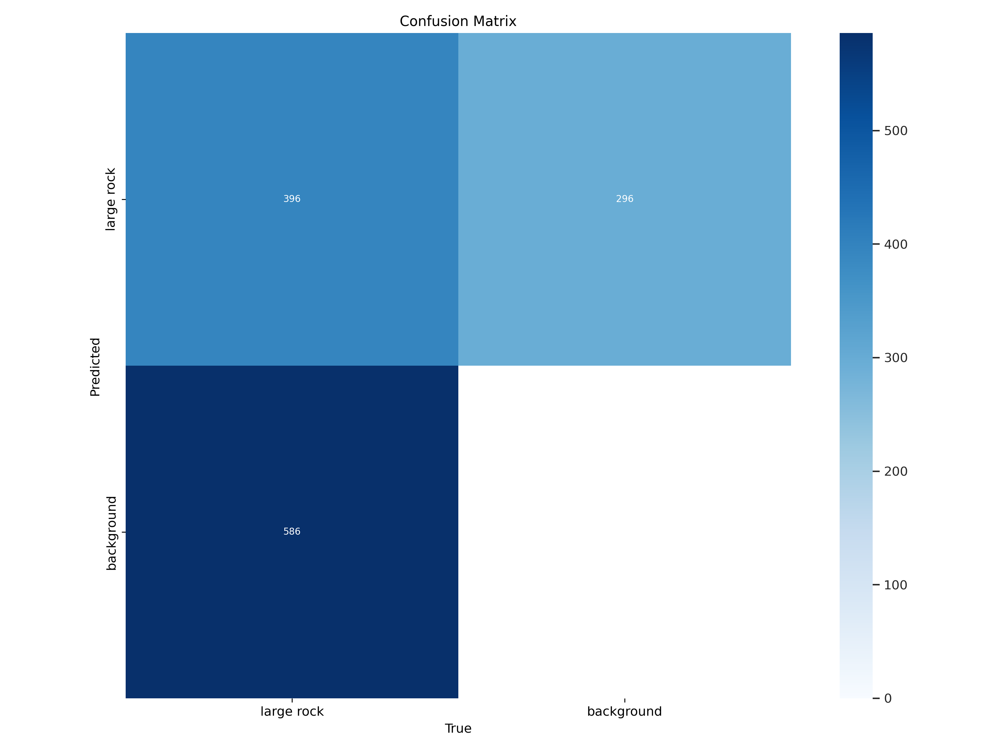

In [ ]:
from IPython.display import display, Image
from IPython import display
display.clear_output()

Image(filename=f'/content/runs/detect/train/confusion_matrix.png', width=600)

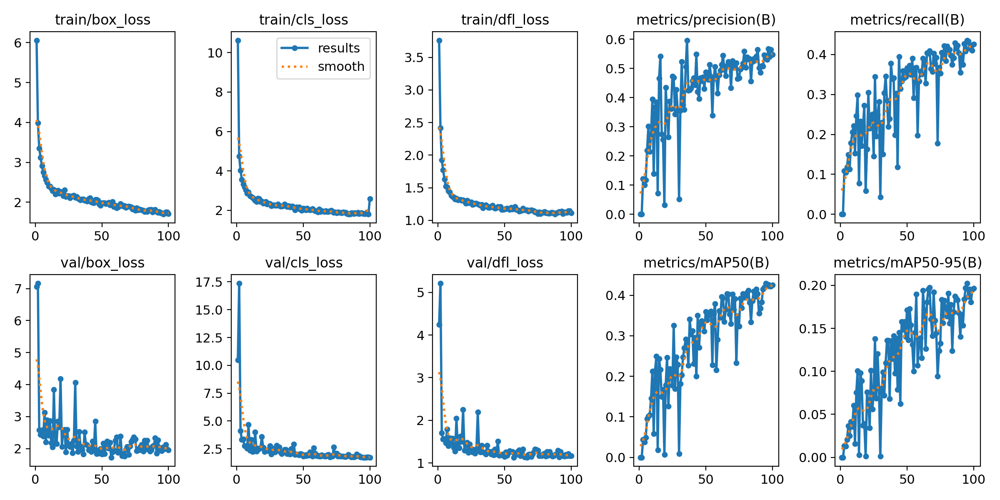

In [ ]:
Image(filename=f'/content/runs/detect/train/results.png', width=600)

# Prediction

In [ ]:
# Load your trained model
model = YOLO('/content/runs/detect/train/weights/best.pt')  # Replace with the path to your model

In [ ]:
# Folder containing images
image_folder = os.path.join(data_root, 'PseudoRGB/images/val')

# Make predictions on all images in the folder
results = model.predict(source=image_folder, save=True)


image 1/248 /content/drive/MyDrive/IPEO/Project/LargeRocksDetectionDataset/PseudoRGB/images/val/2581_1126_0_2.tif: 640x640 2 large rocks, 10.0ms
image 2/248 /content/drive/MyDrive/IPEO/Project/LargeRocksDetectionDataset/PseudoRGB/images/val/2581_1126_2_1.tif: 640x640 16 large rocks, 37.1ms
image 3/248 /content/drive/MyDrive/IPEO/Project/LargeRocksDetectionDataset/PseudoRGB/images/val/2581_1126_3_3.tif: 640x640 4 large rocks, 10.0ms
image 4/248 /content/drive/MyDrive/IPEO/Project/LargeRocksDetectionDataset/PseudoRGB/images/val/2581_1127_0_0.tif: 640x640 (no detections), 15.0ms
image 5/248 /content/drive/MyDrive/IPEO/Project/LargeRocksDetectionDataset/PseudoRGB/images/val/2581_1127_0_2.tif: 640x640 3 large rocks, 18.6ms
image 6/248 /content/drive/MyDrive/IPEO/Project/LargeRocksDetectionDataset/PseudoRGB/images/val/2581_1127_1_0.tif: 640x640 (no detections), 15.0ms
image 7/248 /content/drive/MyDrive/IPEO/Project/LargeRocksDetectionDataset/PseudoRGB/images/val/2581_1127_2_0.tif: 640x640 2

In [ ]:
from PIL import Image

def visualize_prediction():

  image_width = 640
  image_height = 640

  # Assuming data, data_root, and sample_info are already defined
  file_name = random.choice(data_splits['val'])

  print('File name:', file_name)
  src_SI = os.path.join(data_root, 'swissImage_50cm_patches', file_name)
  src_HS = os.path.join(data_root, 'swissSURFACE3D_hillshade_patches', file_name)
  src_LAB = os.path.join(data_root, 'PseudoRGB/labels/val', file_name.replace('.tif', '.txt'))
  src_PRED = os.path.join('/content/runs/detect/predict', file_name.replace('.tif', '.jpg'))


  # Load the swissIMAGE and swissSURFACE3D images
  image = tifffile.imread(src_SI)
  dsm = tifffile.imread(src_HS)
  image_pred = Image.open(src_PRED)

  # Create a figure with 3 subplots
  fig, ax = plt.subplots(1, 3, figsize=(21, 7))

  # Plot swissIMAGE
  ax[0].imshow(image)
  ax[0].axis('off')
  ax[0].set_title('swissIMAGE')

  # Plot swissSURFACE3D
  ax[1].imshow(dsm, cmap='gist_gray')
  ax[1].axis('off')
  ax[1].set_title('swissSURFACE3D')

  x_coords = []
  y_coords = []

  with open(src_LAB, 'r') as file:
    for line in file:
      parts = line.strip().split()
      #print(len(parts))
      if len(parts) >= 5:
        try:
          x = float(parts[1]) * image_width
          y = float(parts[2]) * image_height
          x_coords.append(x)
          y_coords.append(y)
        except ValueError:
          print(f"No rock found or invalid line")

  for j in range(len(x_coords)):

      # Create the rectangle
      circ = patches.Circle((x_coords[j], y_coords[j]), radius=20, linewidth=2, edgecolor='r', facecolor='none')
      ax[1].add_patch(circ)

  # For the third plot, use the same background as swissSURFACE3D
  ax[2].imshow(image_pred)  # Use the DSM as the background
  ax[2].set_title('Prediction')
  ax[2].grid(True, which='both', color='gray', linestyle='--', linewidth=1.5)  # Add grid
  ax[2].tick_params(axis='both', which='both', direction='in')  # Add tick marks

  print(f"Number of labels: {len(x_coords)}")
  # Display the plots
  plt.tight_layout()
  plt.show()

File name: 2768_1139_0_0.tif
Number of labels: 0


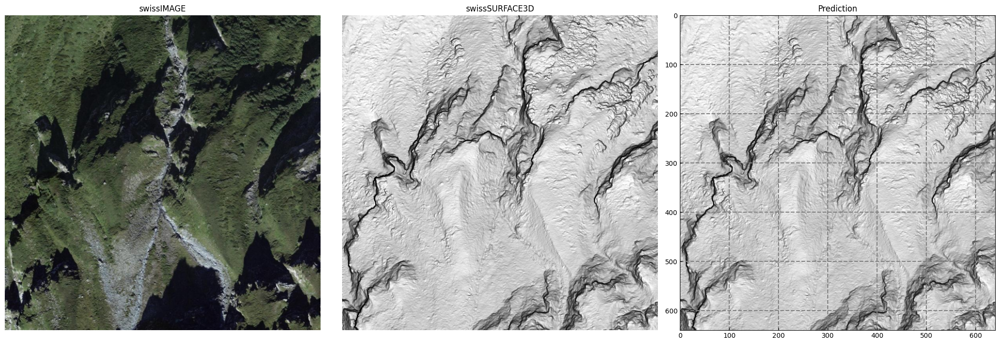

File name: 2583_1126_3_3.tif
Number of labels: 3


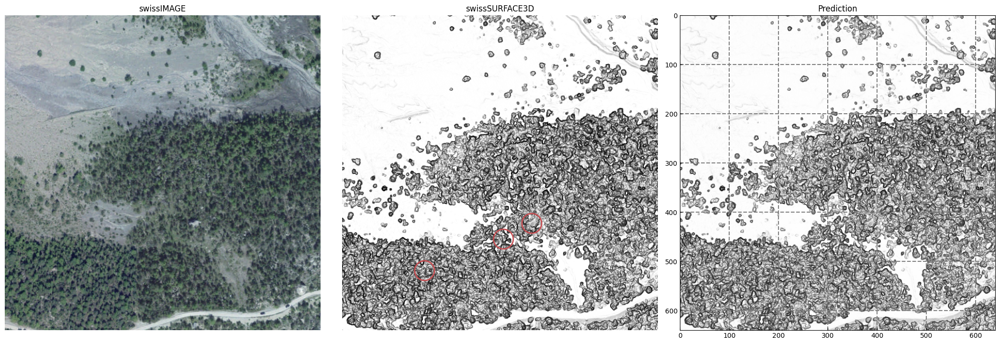

File name: 2639_1105_3_1.tif
Number of labels: 31


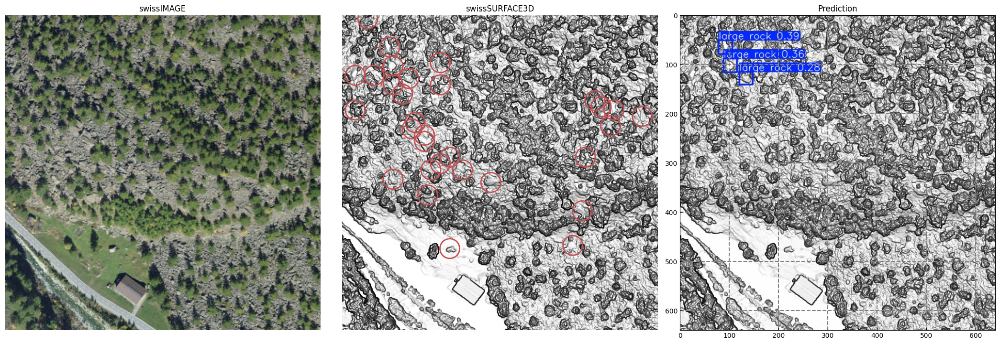

File name: 2627_1109_0_2.tif
Number of labels: 6


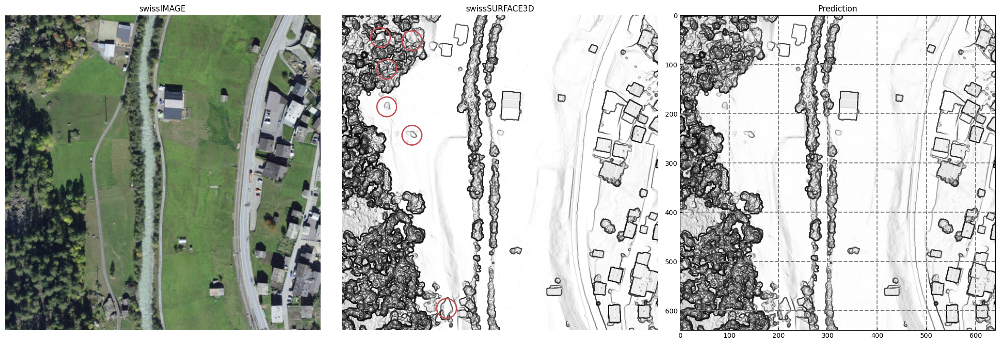

File name: 2781_1140_2_2.tif
Number of labels: 6


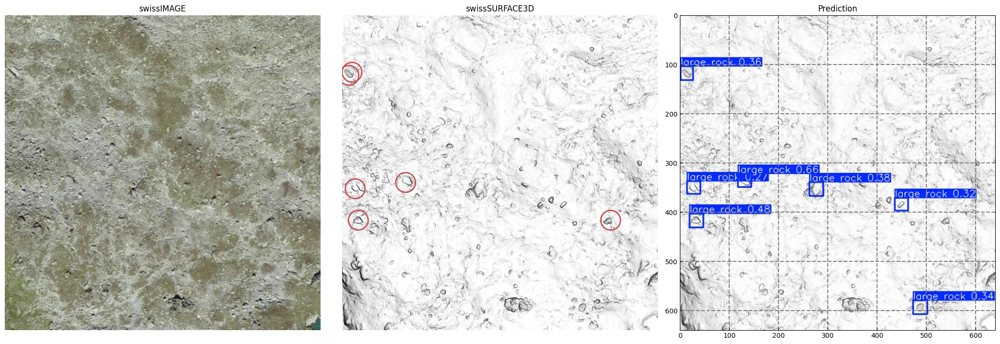

File name: 2634_1145_2_1.tif
Number of labels: 0


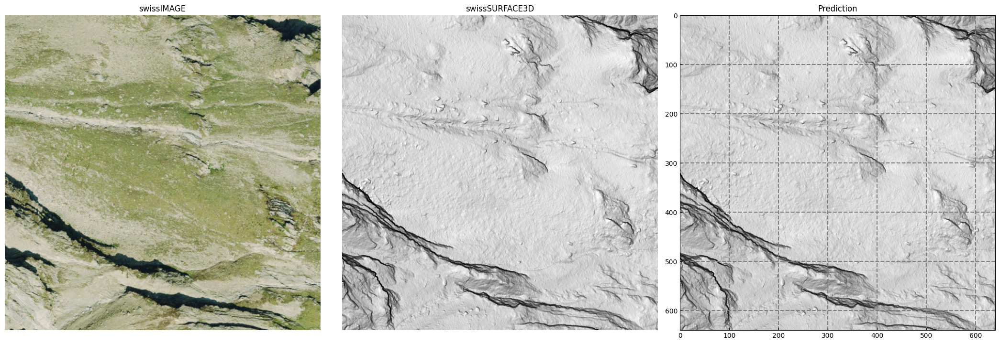

File name: 2627_1103_1_3.tif
Number of labels: 5


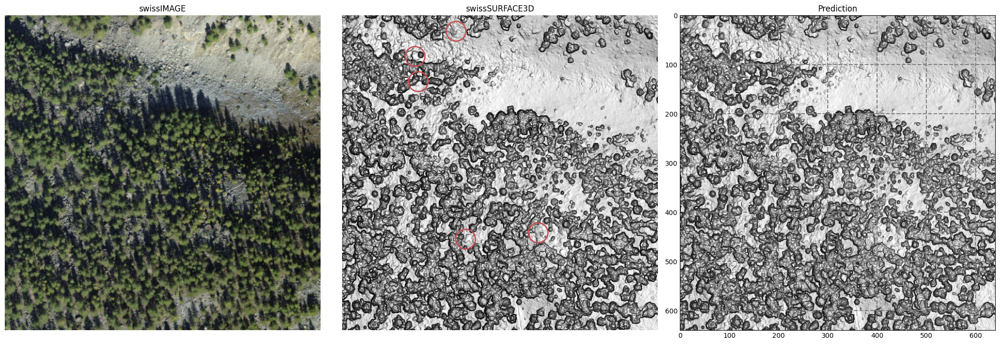

File name: 2593_1130_1_2.tif
Number of labels: 12


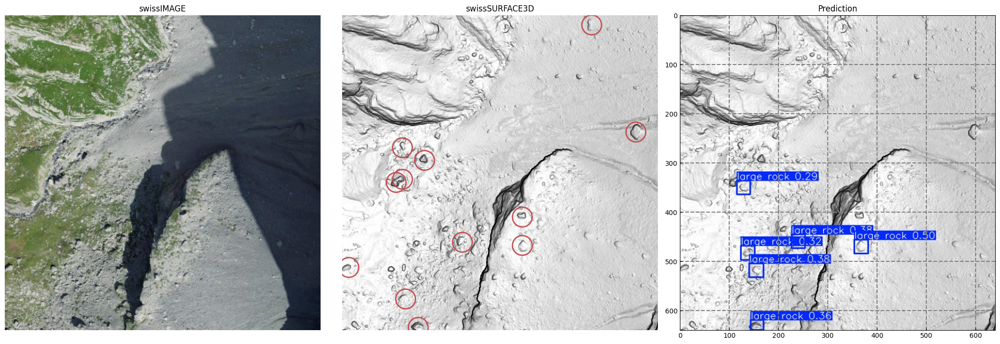

File name: 2597_1131_1_0.tif
Number of labels: 0


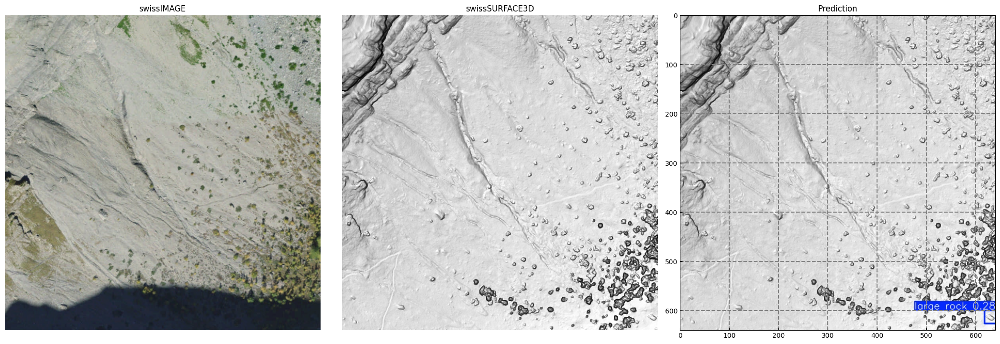

File name: 2638_1110_1_0.tif
Number of labels: 0


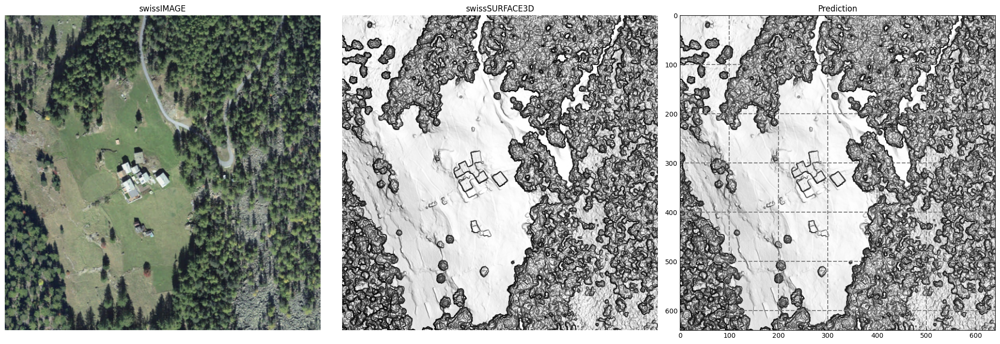

In [ ]:
for i in range(10):
  visualize_prediction()

# Conclusion: Grayscale images more suitable for edge detection, feature extraction or pattern recognition. Color informations is necessary for more accurate training. E.g. images with lot of green, rocks with have larger R value than G.
# Future tests:
- replace one of the image channels with hillshade (e.g. B)
- try to make 4 channels input works